In [1]:
import librosa
import numpy as np
import matplotlib.pyplot as plt

## Decode an audio file

In [2]:
from babycat import Waveform

w = Waveform.from_file(
    "/audio/circus-of-freaks/track.mp3",
    end_time_milliseconds=30_000,
)

## Get information about it

In [3]:
print(w.frame_rate_hz, "hz")
print(w.num_frames, "frames")
print(w.num_channels, "channels")
arr = w.to_numpy()
arr

44100 hz
1323000 frames
2 channels


array([[ 0.0002329 ,  0.00044409],
       [ 0.000488  ,  0.00068076],
       [ 0.00094175,  0.00100227],
       ...,
       [ 0.15670778, -0.02268355],
       [ 0.16640772, -0.041037  ],
       [ 0.16873349, -0.04701887]], dtype=float32)

## Listen to it

In [4]:
w

<babycat.Waveform: 1323000 frames, 2 channels, 44100 hz>

## Listen to it...twice as fast

In [5]:
Waveform.from_numpy(arr=arr, frame_rate_hz=w.frame_rate_hz * 2)

<babycat.Waveform: 1323000 frames, 2 channels, 88200 hz>

## Or twice as slow

In [6]:
Waveform.from_numpy(arr=arr, frame_rate_hz=w.frame_rate_hz // 2)

<babycat.Waveform: 1323000 frames, 2 channels, 22050 hz>

## Plot the waveform (with matplotlib)

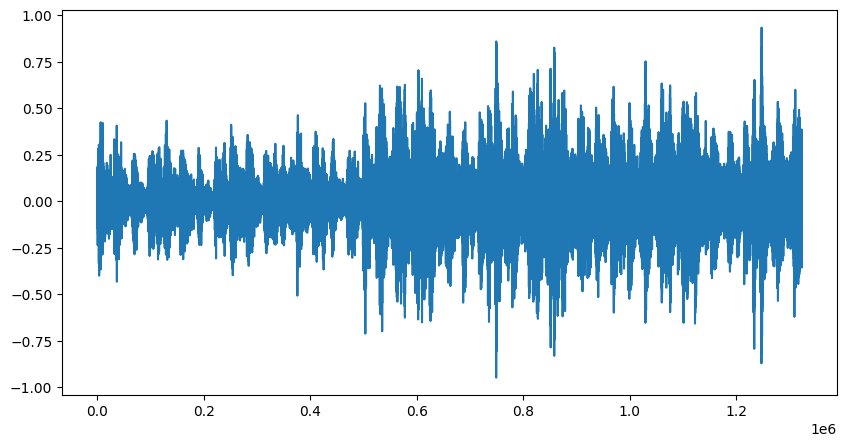

In [7]:
plt.figure(figsize=(10,5))
plt.plot(
    arr[:,0]
)

## Plot the decibel-scaled Short-time Fourier Transform (STFT) (with librosa)

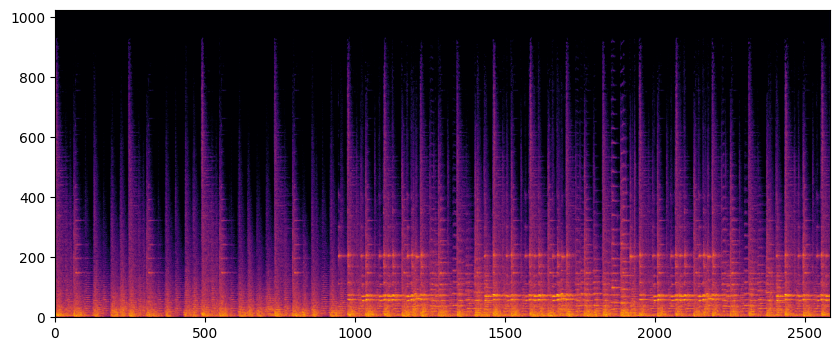

In [8]:
stft = librosa.stft(np.expand_dims(arr[:,0], axis=0))[0]
magnitude = np.absolute(stft)
db_magnitude = librosa.amplitude_to_db(magnitude)
plt.figure(figsize=(10,5))
plt.imshow(
    db_magnitude,
    origin="lower",
    #aspect="equal",
    cmap="inferno",
)